<link rel="stylesheet" href="../../styles/theme_style.css">
<!--link rel="stylesheet" href="../../styles/header_style.css"-->
<link rel="stylesheet" href="https://cdnjs.cloudflare.com/ajax/libs/font-awesome/4.7.0/css/font-awesome.min.css">

<table width="100%">
    <tr>
        <td id="image_td" width="15%" class="header_image_color_4"><div id="image_img"
        class="header_image_4"></div></td>
        <td class="header_text"> Computing SNR for ECG Signals </td>
    </tr>
</table>

<div id="flex-container">
    <div id="diff_level" class="flex-item">
        <strong>Difficulty Level:</strong>   <span class="fa fa-star checked"></span>
                                <span class="fa fa-star checked"></span>
                                <span class="fa fa-star"></span>
                                <span class="fa fa-star"></span>
                                <span class="fa fa-star"></span>
    </div>
    <div id="tag" class="flex-item-tag">
        <span id="tag_list">
            <table id="tag_list_table">
                <tr>
                    <td class="shield_left">Tags</td>
                    <td class="shield_right" id="tags">pre-process&#9729;ecg&#9729;noise&#9729;snr</td>
                </tr>
            </table>
        </span>
        <!-- [OR] Visit https://img.shields.io in order to create a tag badge-->
    </div>
</div>

A very important parameter to consider when analysing a signal is the <strong><span class = "color2">Signal to Noise Ratio (SNR)</span></strong> - a metric that classifies objectively the quality of the acquisition, and like the name suggests, the relation between the intensity of the signal and the undesired noise in the acquired data, which is defined by: $ \\SNR=  \frac{V_{pp}^{signal}}{V_{pp}^{noise}}\\ $, being $V_{pp}^{signal}$ and $V_{pp}^{noise}$ the peak-to-peak amplitude of the signal and noise segment, respectively.

To obtain this parameter, there is a big difference in the procedure when applying it to slow and rapid signals. Slow signals, as expected, have slow oscillations. To find the noise signal, you just have to subtract the filtered signal to the raw one. However, when it comes to rapid signals, such as the electrocardiography (ECG) signal, you would not have a correct noise signal this way.

In this <strong><span class = "color5">Jupyter Notebook</span></strong> you will learn how to compute the <strong><span class = "color2">SNR</span></strong> values for ECG signals, using samples that are available in our website.

<hr>

<p class="steps">1 - Importation of the required packages</p>

In [1]:
# Importing specific functions from the numpy Python package
from numpy import ptp, zeros, mean
# biosignalsnotebooks python package
import biosignalsnotebooks as bsnb
import numpy as np
import matplotlib.pyplot as plt
# Package to calculate SNR with log
from math import log10
from scipy.interpolate import interp1d
from scipy import signal
from scipy import integrate

<p class="steps">2 - Opening files and storing data in variables</p>
If this step is challenging for you, try this <strong><span class = "color5">Jupyter Notebooks</span></strong> on <span class = "color1"><a href = "../Load/open_txt.ipynb">Opening a .txt file <img height="10px" src="../../images/icons/link.png" style="display:inline" width="10px"></a></span> and  <span class = "color1"><a href = "../Load/signal_loading_preparatory_steps.ipynb">Working with file headers <img height="10px" src="../../images/icons/link.png" style="display:inline" width="10px"></a></span>.

<p class="steps">2.2 - Opening ECG file </p>

In [2]:
# ECG file
data_ecg, header_ecg = bsnb.load("C:/Users/rendai/Documents/OpenSignals (r)evolution/opensignals_relax.txt", get_header=True)

# The loaded data is in the form of Python dictionary, where the first entry is the mac address 
# of the first device of the acquisition. This line, extracts that mac address.
mac_address = list(header_ecg.keys())[0]

# For this particular acquisition, the ECG data corresponds to the data in channel 1.
signal_ecg = data_ecg['CH1']

<p class="steps">3 - ECG Analysis</p>
<strong><span class = "color2">Eletrocardiogram (ECG)</span></strong> is a signal that describes the electrical activity of the heart. It is one of the most known biological signals! This signal is repetitive and has many cycles per minute.<br>

<p class="steps">3.1 - Conversion of the raw signal to its physical meaning</p>
The device used to acquire signals provides the raw data for post analyses. Thus, before starting the interpretation and processing, we will convert it to physical units, that in the case of voltage corresponds to Volts or milliVolts (V or mV) using the transfer function that is already implemented in the <strong><span class = "color7">biosignalsnotebooks</span></strong> Python package. This transfer function may be accessed in the sensor <a href="https://plux.info/datasheets/ECG_Sensor_Datasheet.pdf#page=2">datasheet <img src="../../images/icons/link.png" width="10px" height="10px" style="display:inline"></a>.

In [3]:
# Get the sampling rate of the acquisition
sampling_rate_ecg = header_ecg['sampling rate']

# Get the resolution of the sensor
resolution = header_ecg['resolution'][0]

# Converting signal to mV (microVolts) unit
signal_mv = bsnb.raw_to_phy('ECG', 'biosignalsplux', signal_ecg, resolution, option='mV')

# Time axis generation
time_ecg= bsnb.generate_time(signal_mv, sampling_rate_ecg)

<p class = "steps">3.2 - Graphic Representation of raw signal</p>
Notice the repetitive nature of the signal and also how fast it varies over time.

In [4]:
# Creating the graphic
bsnb.plot(time_ecg, signal_mv, title="Raw ECG", y_axis_label = "ECG Signal (mV)", x_axis_label = "Time (s)")

<p class = "steps"> 3.3 - Measuring <span class = "color5">Vpp<sup>signal</sup></span>: peak-to-peak amplitude of the signal component </p>
Since the $V_{pp}^{signal}$ corresponds to the difference between the <span class="color7"><strong>maximum</strong></span> and <span class="color1"><strong>minimum</strong></span> values of the signal, we first must find them in order to proceed to the subsequent subtraction. Fortunately, Python and <strong>numpy</strong> offer functions to simplify this process.

In [5]:
# Finding the maximum and minimum values of the ECG signal
max_ecg = max(signal_mv)
min_ecg = min(signal_mv)

# Calculating the amplitude of the signal
vpp_signal_ecg = max_ecg - min_ecg

# Notice that this procedure is condensed in a single function in the numpy Python package:
vpp_signal_ecg = ptp(signal_mv)

In [6]:
print("Amplitude of ECG signal: {} mV".format(vpp_signal_ecg))

Amplitude of ECG signal: 49.49705593719334 mV


The next plot is a visual representation of the procedure. The V<sub>pp</sub> value is given by the absolute difference between the lines that encompass the ECG signal.

In [7]:
#Another visual help to guide you
length_ecg = len(signal_mv)

max_line = zeros(length_ecg) + max_ecg
min_line = zeros(length_ecg) + min_ecg

bsnb.plot([time_ecg, time_ecg,time_ecg],[signal_mv, min_line, max_line], color=['#009EE3', '#E84D0E', '#E84D0E'],
          title="ECG Signal Amplitude", y_axis_label = "ECG Signal (mS)", x_axis_label = "Time (s)")

<p class = "steps">3.4 - Noise signal and measuring <span class = "color5">V<sub>pp</sub><sup>noise</sup></span>: peak-to-peak amplitude of the noise component.</p>
    Here is an overview on how you should proceed to measure peak to peak amplitude for the noise component on repetitive and fast varying signals, specifically ECG signals:
<ol>
    <li>Slice the signal into several single-beat signals</li>
    <li>Compute the amplitude from all the areas where there is no presence of ECG signal and average all the obtained values to define the final Vpp noise value</li>
</ol>

<p class = "steps">3.4.1 - Finding R Peaks</p>
The typical heartbeat in an ECG signal is composed by various waves that correspond to specific events in the heart. Specifically, there are the P, Q, R, S and T waves that occur in the heart during the contraction and relaxation of the atria, and contraction and relaxation of the ventricles. Being the <strong><span class = "color4">R peak</span></strong> the most noticeable wave of each heartbeat, algorithms for heartbeat detection usually focus on finding these structures.<br>
In this case, we will use the Pan-Tompkins algorithm, which allows to rapidly and accurately detect R peaks. For this, we will use the <strong><span class = "color2">biosignalsnotebooks</span></strong> Python package.

In [8]:
time_r_peaks, amplitude_r_peaks = bsnb.detect_r_peaks(signal_mv, sampling_rate_ecg, time_units=True, plot_result= True)



In [9]:
print(len(time_r_peaks))

362


In [10]:
index=0
con: int =len(time_r_peaks)/2

time_r_peaks_lenge=[]
    
while index<con:
    time_r_peaks_lenge=np.append(time_r_peaks_lenge,time_r_peaks[index+1]-time_r_peaks[index])
    index=index+1
print(len(time_r_peaks_lenge))
print(index)


181
181


In [11]:
x=range(len(time_r_peaks_lenge))
x_latent = np.linspace(min(x), max(x), 10000)

from scipy import interpolate
ip1 = ["最近傍点補間", lambda x, y: interpolate.interp1d(x, y, kind="nearest")]
ip2 = ["線形補間", interpolate.interp1d]
ip3 = ["ラグランジュ補間", interpolate.lagrange]
ip4 = ["重心補間", interpolate.BarycentricInterpolator]
ip5 = ["Krogh補間", interpolate.KroghInterpolator]
ip6 = ["2次スプライン補間", lambda x, y: interpolate.interp1d(x, y, kind="quadratic")]
ip7 = ["3次スプライン補間", lambda x, y: interpolate.interp1d(x, y, kind="cubic")]
ip8 = ["秋間補間", interpolate.Akima1DInterpolator]
ip9 = ["区分的 3 次エルミート補間", interpolate.PchipInterpolator]

3次スプライン補間


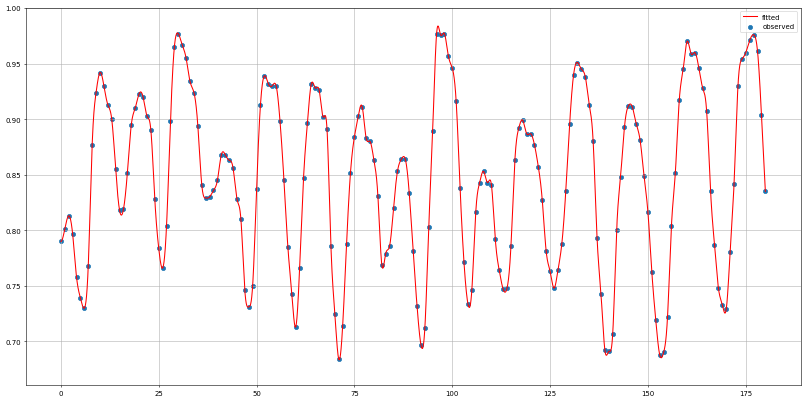

In [12]:
for method_name, method in [ip7]:
    print(method_name)
    plt.figure(figsize=(20, 10), dpi=50)

    fitted_curve = method(x, time_r_peaks_lenge)
    plt.scatter(x, time_r_peaks_lenge, label="observed")
    plt.plot(x_latent, fitted_curve(x_latent), c="red", label="fitted")
    plt.grid()
    plt.legend()
    plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\scipy\signal\spectral.py:1970: UserWarning: nperseg = 256 is greater than input length  = 181, using nperseg = 181
  .format(nperseg, input_length))


<Figure size 432x288 with 0 Axes>

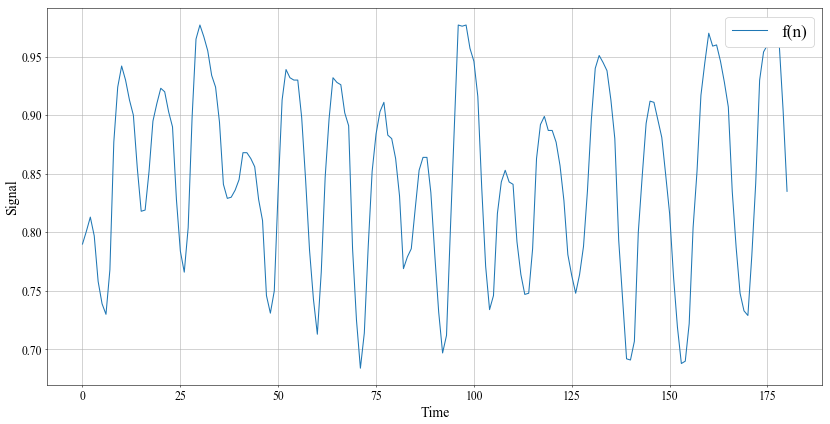

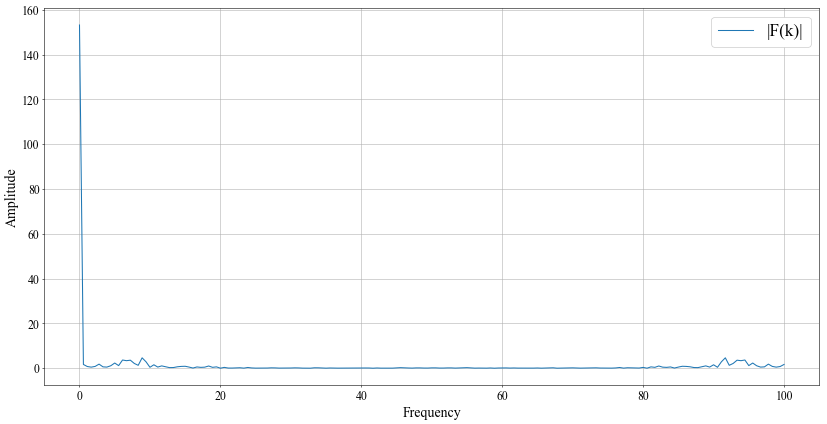

In [13]:
N = 181            # サンプル数
dt = 0.01          # サンプリング間隔
freq = np.linspace(0, 1.0/dt, N)
F = np.fft.fft(time_r_peaks_lenge)
fs=1/dt
# 振幅スペクトルを計算
Amp = np.abs(F)
freq2, P2 = signal.welch(time_r_peaks_lenge, fs)

# パワースペクトルの計算（振幅スペクトルの二乗）


# グラフ表示
plt.figure()
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 17
plt.figure(figsize=(20, 10), dpi=50)

plt.plot(x, time_r_peaks_lenge, label='f(n)')
plt.xlabel("Time", fontsize=20)
plt.ylabel("Signal", fontsize=20)
plt.grid()
leg = plt.legend(loc=1, fontsize=25)
leg.get_frame().set_alpha(1)
plt.figure(figsize=(20, 10), dpi=50)
plt.plot(freq,Amp, label='|F(k)|')
plt.xlabel('Frequency', fontsize=20)
plt.ylabel('Amplitude', fontsize=20)
plt.grid()
leg = plt.legend(loc=1, fontsize=25)
leg.get_frame().set_alpha(1)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: RankWarning: Polyfit may be poorly conditioned
  # Remove the CWD from sys.path while we load stuff.


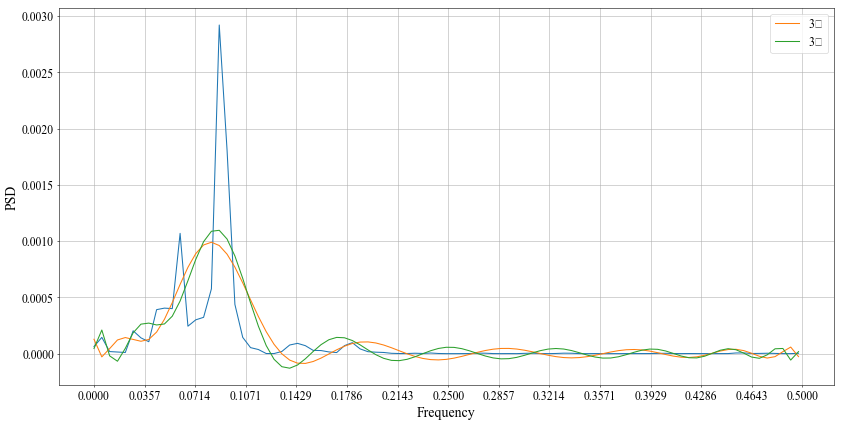

In [14]:

plt.figure(figsize=(20, 10), dpi=50)
plt.xlabel('Frequency', fontsize=20)
plt.ylabel('PSD', fontsize=20)
plt.xticks(np.linspace(0, 0.5, num=15, endpoint=True))
plt.plot(freq2*0.01,P2)
plt.grid()
res1=np.polyfit(freq2*0.01,P2,18)
res2=np.polyfit(freq2*0.01,P2,15)
res3=np.polyfit(freq2*0.01,P2,21)
y1=np.poly1d(res1)(freq2*0.01)
y2=np.poly1d(res2)(freq2*0.01)
y3=np.poly1d(res3)(freq2*0.01)
plt.plot(freq2*0.01, y2, label='3次')
plt.plot(freq2*0.01, y3, label='3次')
plt.legend()
plt.show()

In [15]:
print(res3)

[ 1.35044974e+13 -5.34968985e+13  9.09097336e+13 -8.32000323e+13
  3.91948927e+13 -2.41230037e+12 -7.95338034e+12  3.96829769e+12
  1.62941705e+11 -1.07455963e+12  6.25618350e+11 -2.10689441e+11
  4.81494013e+10 -7.80694898e+09  9.05147066e+08 -7.41091085e+07
  4.15916224e+06 -1.52190698e+05  3.34650051e+03 -3.80537985e+01
  1.59998975e-01  4.56817552e-05]


In [16]:
print(np.poly1d(res3)) 
print(np.poly1d(res2)) 

          21            20             19            18             17
1.35e+13 x  - 5.35e+13 x  + 9.091e+13 x  - 8.32e+13 x  + 3.919e+13 x 
              16             15             14             13
 - 2.412e+12 x  - 7.953e+12 x  + 3.968e+12 x  + 1.629e+11 x 
              12             11             10             9
 - 1.075e+12 x  + 6.256e+11 x  - 2.107e+11 x  + 4.815e+10 x
              8             7             6             5             4
 - 7.807e+09 x + 9.051e+08 x - 7.411e+07 x + 4.159e+06 x - 1.522e+05 x
         3         2
 + 3347 x - 38.05 x + 0.16 x + 4.568e-05
           15             14             13             12
-1.46e+09 x  + 5.583e+09 x  - 9.624e+09 x  + 9.874e+09 x 
              11             10             9             8
 - 6.708e+09 x  + 3.176e+09 x  - 1.074e+09 x + 2.611e+08 x
             7             6            5             4         3
 - 4.54e+07 x + 5.536e+06 x - 4.57e+05 x + 2.414e+04 x - 748.5 x
          2
 + 12.03 x - 0.07564 x + 0.0001

In [17]:
print(res3[0])

13504497377424.428


In [37]:
def computePi(x):
    return res3[0]*x**21+res3[1]*x**20+res3[2]*x**19+res3[3]*x**18+res3[4]*x**17+res3[5]*x**16+res3[6]*x**15+res3[7]*x**14+res3[8]*x**13+res3[9]*x**12+res3[10]*x**11+res3[11]*x**10+res3[12]*x**9+res3[13]*x**8+res3[14]*x**7+res3[15]*x**6+res3[16]*x**5+res3[17]*x**4+res3[18]*x**3+res3[19]*x**2+res3[20]*x+res3[21]

LF=integrate.quad(computePi,0.004,0.15)
HF=integrate.quad(computePi,0.15,0.4)

In [32]:

def computePi2(x):
    return res2[0]*x**15+res2[1]*x**14+res2[2]*x**13+res2[3]*x**12+res2[4]*x**11+res2[5]*x**10+res2[6]*x**9+res2[7]*x**8+res2[8]*x**7+res2[9]*x**6+res2[10]*x**5+res2[11]*x**4+res2[12]*x**3+res2[13]*x**2+res2[14]*x+res2[15]

LF2=integrate.quad(computePi,0.004,0.15)
HF2=integrate.quad(computePi,0.15,0.4)

In [38]:
#計測LFとHF
print(LF)
print(HF)

(5.3618889167983e-05, 1.6878592419431106e-17)
(3.7584848721628254e-06, 6.202771502579546e-11)


In [39]:
print(LF[0]/HF[0]/10)

1.4266091521376254


In [35]:
#計測LFとHF
print(LF2)
print(HF2)

(5.3618889167983e-05, 1.6878592419431106e-17)
(3.7584848721628254e-06, 6.202771502579546e-11)


In [36]:
print(LF2[0]/HF2[0]/10)

1.4266091521376254


In [101]:
<strong>Representation of noise segment in one beat</strong>

In order to explain the used method to calculate the SNR for ECG signals, we are giving a visual example using just one beat -  we choose the fifth one. As previously mentioned, you should slice the noise  segment in intervals to minimize errors when measuring noise signal amplitude. We broke it into 20 intervals. <strong>You do not have to worry about the code bellow</strong> as it is just a way to clarify the method to find the noise amplitude. Look at the graphic and notice:
    <ul>
        <li>One heartbeat of the ECG - <strong><span class="color2">meaningful values</span></strong>;</li>
        <li>The <strong><span class="color7">noise segment</span></strong>;</li>
        <li>Another heartbeat of the ECG - <strong><span class="color2">meaningful values</span></strong>.</li>
    </ul>

SyntaxError: invalid syntax (<ipython-input-101-4896e1961a14>, line 1)

In [ ]:
# Time of the onset of the sixth R peak (remember that Python lists and arrays start at 0)
onset_sixth_hb = time_r_peaks[5]

# Time of the onset of the fifth R peak
onset_fifth_hb = time_r_peaks[4]

# The start of the noise corresponds to the interval between peaks. Through observation, the fifth heartbeat ends at
# around 0.5 s after its start, while the sixth starts at around 0.65 s after the start of the previous
time_start_noise = onset_sixth_hb + 0.5
time_end_noise = onset_sixth_hb + 0.65

# Then, we need to convert it to index to identify it in the signal. The values are cast to integers because all indexes are integers.
start_noise = int(time_start_noise * sampling_rate_ecg)
end_noise = int(time_end_noise * sampling_rate_ecg)

# Now we will identify the heartbeats. The procedure is analogous, and so we will do it in single lines.
# The parcels of 0.7 and 1.5 correspond to emprical values that need to be added to the R peaks in order
# to identify the onset of the heartbeats, once they do not start with the R peaks.
time_start = time_ecg[int((onset_fifth_hb + .7)*sampling_rate_ecg):start_noise]
beat_start = signal_mv[int((onset_fifth_hb+ .7)*sampling_rate_ecg):start_noise]

time_end = time_ecg[end_noise:int((onset_sixth_hb + 1.5)*sampling_rate_ecg)]
beat_end = signal_mv[end_noise:int((onset_sixth_hb + 1.5)*sampling_rate_ecg)]

# signal with noise values
time_noise = time_ecg[start_noise:end_noise]
beat_noise = signal_mv[start_noise:end_noise]

In [ ]:
#Graphic 
bsnb.plot([time_start, time_end,time_noise],[beat_start, beat_end, beat_noise], color=['#009EE3', '#009EE3', '#11E868'], 
          title="ECG - One Beat", y_axis_label = "ECG Signal (mS)", x_axis_label = "Time (s)")

<strong>One of several intervals to measure amplitude of noise signal</strong>

In [ ]:
#Another visual help to guide you
length_noise = len(beat_noise)

max_line = zeros(length_noise) + max(beat_noise)
min_line = zeros(length_noise) + min(beat_noise)

bsnb.plot([time_noise, time_noise,time_noise],[min_line, max_line, beat_noise], color=['#E84D0E', '#E84D0E', '#009EE3'],
          title="ECG - Noise Segment Amplitude", y_axis_label = "ECG Signal (mS)", x_axis_label = "Time (s)")

<p class = "steps">3.4.2 - Compute the average noise amplitude</p>
To get a more precise value for the amplitude of noise, one should consider the noise present in the <strong class="color2">signal as a whole</strong>. However, once ECG signal is composed of high and low frequency components, it is not possible to just separate noise using either a low pass or a high pass filter. Thus, our approach is to identify every interval between heartbeats, that should correspond to <strong class="color4">flat lines</strong> with no signal. Thus, by getting the average value of the amplitude of those segments, we get an <strong class="color7">estimate of the amplitude</strong> of the noise in the signal.

In [ ]:
vpp_noise_ecg = []

# For this task, we will follow the same procedure as shown before, but store the values in a list, so that we can then calculate the mean value.
for t in time_r_peaks:
    start = int((t + 0.5) * sampling_rate_ecg) # 0.5 - time between a peak and a flat 
    end = int((t + 0.65)* sampling_rate_ecg) # 0.65 time between a peak and the end of the flat
    interval = signal_mv[start:end]
  
    vpp = ptp(interval)
    vpp_noise_ecg.append(vpp)
    
vpp_noise_ecg = mean(vpp_noise_ecg)

In [ ]:
print("Amplitude of noise signal: {} mV".format(vpp_noise_ecg))

<p class = "steps">3.5 - Computing <span class = "color13">SNR</span> (dB)</p>
Though the formula for the signal to noise ratio shown before is valid, it is more usual to represent this quantity in decibels (dB). This conversion is given by: $ \\SNR=  20 \times log_{10}{\frac{V_{pp}^{signal}}{V_{pp}^{noise}}}\\ $. Both quantities will be calculated.

In [ ]:
snr_ecg = vpp_signal_ecg/vpp_noise_ecg

# The multiplication by 20 is because the signals are in the unit of (micro)Siemes
print(snr_ecg)
a=numpy.log10(snr_ecg)
snr_ecg_db = 20 * log10(snr_ecg)

print("SNR for ECG signal: {}".format(snr_ecg))
print("SNR for ECG signal: {} dB".format(snr_ecg_db))

SNR values are proportional to the quality of the acquisition. Thus, the higher the value, the better the acquisition, because the higher the influence of the signal relative to the noise. Specifically, the signal is higher than the noise if the SNR is higher than 1 (in dB higher than 0) and inversely, if it is below 1 (in dB below 0) the influence of the noise is higher than the influence of the signal and, thus, it might be impossible to recover the signal.

Though signal to noise ratio is important for every type of signal, the process for calculating it for the ECG signal is particular and was here demonstrated. We concluded that the noise influence was low on the overall signal, once the SNR is much higher than 1 (or 0 dB).

<strong><span class="color7">We hope that you have enjoyed this guide. </span><span class="color2">biosignalsnotebooks</span><span class="color4"> is an environment in continuous expansion, so don't stop your journey and learn more with the remaining <a href="../MainFiles/biosignalsnotebooks.ipynb">Notebooks <img src="../../images/icons/link.png" width="10px" height="10px" style="display:inline"></a></span></strong> !

<span class="color6"><strong>Auxiliary Code Segment (should not be replicated by
the user)</strong></span>

In [ ]:
from biosignalsnotebooks.__notebook_support__ import css_style_apply
css_style_apply()

In [ ]:
%%html
<script>
    // AUTORUN ALL CELLS ON NOTEBOOK-LOAD!
    require(
        ['base/js/namespace', 'jquery'],
        function(jupyter, $) {
            $(jupyter.events).on("kernel_ready.Kernel", function () {
                console.log("Auto-running all cells-below...");
                jupyter.actions.call('jupyter-notebook:run-all-cells-below');
                jupyter.actions.call('jupyter-notebook:save-notebook');
            });
        }
    );
</script>